# Convolutional Character Networks

    Convolutional Character Networks
    Linjie Xing, Zhi Tian, Weilin Huang, and Matthew R. Scott;
    In: Proceedings of the IEEE International Conference on Computer Vision (ICCV), 2019.
    
Paper : https://arxiv.org/abs/1910.07954

Code : https://github.com/MalongTech/research-charnet

**Presentation**

Convolutional Character Networks (referred as CharNet)
- joint text detection and recognition
- by leveraging character as basic unit
- first one-stage CNN model for the joint tasks
- outperforms recent two stage approaches by a large margin,
- improvement of 65.33% -> 71.08% (generic lexicon) on ICDAR 2015
- improvement of 54.0% -> 69.23% (E2E) on Total-Text
- can achieve comparable results, e.g., 67.24% on ICDAR 2015, even without lexicon

CharNet
- direct character detection and recognition
- jointly with text instance (e.g., word) detection
- avoid limitations of current two-stage framework
  - RoI (Region of Interest) cropping and pooling
  - RNN-based word recognition
- simple, compact, yet powerful model
- directly outputs 
  - bounding boxes of words and characters
  - as well as the corresponding character labels

Drawbacks of 2 stages RoI cropping and pooling methods
- difficult to crop an accurate text region for feature pooling
- a large amount of background information may be included
- leads to significant performance degradation on recognition task
- particularly for multi-orientation or curved text

Advantages of characters detection over words detection
- word-level detection requires to cast text recognition into a sequence labelling problem
- a RNN model with additional modules, such as CTC or attention mechanism is needed (see below) 
- unlike English, words are not clearly distinguishable in some languages such as Chinese
- characters are more clearly-defined elements that generalize better over various languages
- character recognition is straightforward, and can be implemented with a simple CNN model

Drawbacks of RNN-based recognition methods
- word-level optimization with a sequential model
- significantly larger search space than direct character classification
- makes the models more complicated and difficult to train
- requires a significantly longer training time with a large amount of training samples




Iterative character detection method
- allows CharNet to transform the character detection capability learned from synthetic data to realworld images
- makes it possible for training CharNet on real-world images
- without providing additional charlevel bounding boxes

CharNet has a character branch that directly outputs accurate charlevel bounding boxes. 

This enables it to automatically identify characters, allowing it to work in a weakly-supervised manner by using the proposed iterative character detection.

This results in a distinct capability for training CharNet without additional char-level bounding boxes in real-world images

**Architecture**

Related works :
- in [41], EAST was introduced by exploring IOU loss [39] (Intersection over Union)

[39] J. Yu, Y. Jiang, Z. Wang, Z. Cao, and T. Huang. Unitbox: An advanced object detection network. In Proceedings of the 2016 ACM on Multimedia Conference, pages 516–520. ACM, 2016. 2

[41] X. Zhou, C. Yao, H. Wen, Y. Wang, S. Zhou, W. He, and J. Liang. East: an efficient and accurate scene text detector. In Proc. CVPR, pages 2642–2651, 2017.

CharNet overview :
- one-stage convolutional architecture
- consisting of two branches
- (1) a character branch designed for direct character detection and recognition
- (2) a text detection branch predicting a bounding box for each text instance in an image
- the two branches are implemented in parallel
- resulting in an end-to-end trainable model

CharNet output :
- instance-level bounding boxes
- char-level bounding boxes with character labels

CharNet backbones :
- ResNet-50 [8]
- Hourglass [19]

[8] K. He, X. Zhang, S. Ren, and J. Sun. Deep residual learning for image recognition. In Proceedings of the IEEE conference on computer vision and pattern recognition, pages 770–778, 2016.

[19] H. Law and J. Deng. Cornernet: Detecting objects as paired keypoints. In Proceedings of the European Conference on Computer Vision (ECCV), pages 734–
750, 2018.

ResNet-50 architecture (inspired by [41])
- final convolutional maps to implement text detection and recognition
- => convolutional feature maps with 4× down-sampling ratio
- results in high-resolution feature maps that enable CharNet to identify extremely small scale text instances

Hourglass architecture
- stack two hourglass modules
- final feature maps are up-sampled to 1/4 resolution of the input image
- Hourglass-88 is modified from Hourglass-104 in [19]
  - removing two downsampling stages
  - reducing the number of layers in the last stage of each hourglass module by half
  - do not employ the intermediate supervision
- Hourglass-57 is modified from Hourglass-88
  - further removing half number of layers in each stage of hourglass modules

**Character branch**

Uses character as basic unit for detection and recognition, and outputs char-level bounding boxes as well as the corresponding character labels.

- stack of convolutional layers, move densely over the feature maps
- input features maps = final feature maps of the backbone, with 1/4 spatial resolution of the input image
- three sub-branches, for text instance segmentation, character detection and character recognition
- all of the output feature maps from three sub-branches have the same spatial resolution, which is exactly the same as that of the input feature maps (1/4 of the input image)

Text instance segmentation
- three convolutional layers with filter sizes of 3×3, 3×3 and 1×1
- exploits a binary mask as supervision
- outputs 2-channel feature maps indicating text or non-text probability at each spatial location

Character detection
- three convolutional layers with filter sizes of 3×3, 3×3 and 1×1
- outputs 5-channel feature maps, estimating a character bounding box at each spatial location
- each character bounding box is parameterized by five parameters, indicating the distances of current location to the top, bottom, left and right sides of the bounding box (tblr), as well as the orientation of bounding-box (o)
(inspired by EAST [41])

Character recognition
- four convolutional layers with one more 3 × 3 convolutional layer
- character labels are predicted densely over the input feature maps, generating 68-channel probability maps
-  each channel is a probability map for a specific character class among 68 character classes, including 26 English characters, 10 digital numbers and 32 special symbols

The char-level bounding boxes are generated by keeping the bounding boxes having a confident value over 0.95. 

Each generated bounding box has a corresponding character label, which is computed at the corresponding spatial location from the 68-channel cassification maps - by using the maximum of the computed softmax scores.

**Text detection branch**

- designed to identify text instances at a higher level concept, such as words or textlines
- provides strong context information which is used to group the detected characters into text instances
- because directly grouping characters by using characters information (e.g., character locations or geometric features) is heuristic and complicated 
- particularly when multiple text instances are located closely within a region, or for text instances with multiple orientations or in a curved shape
- can be defined in different forms subjected to the type of text instances
- existing instance level text detectors can be adapted with minimum modification

Multi-Orientation Text
- simply modify EAST detector [41] as our text detection branch
- compute dense prediction at each spatial location of the feature maps
- two 3×3 convolutional layers, followed by another 1 × 1 convolutional layer
- contains two sub-branches 
  - text instance segmentation
    - outputs 2-channel feature maps indicating text or non-text probability
  - instance level bounding box regression using IoU loss
    - the predicted bounding boxes are parameterized by five parameters including 4 scalars for a bounding box with an orientation angle
    - outputs 5-channel detection maps for bounding boxes with orientation angles
- keep the bounding boxes having a confident value over 0.95

Curved Text
- we modify Textfield in [38]
- using a direction field, which encodes the direction information that points away from text boundary
- direction field is used to separate adjacent text instances
- can be predicted by a new branch in parallel with text detection branch and character branch
- branch is composed of two 3×3 convolutional layers, followed by another 1×1 convolutional layer

[38] Y. Xu, Y. Wang, W. Zhou, Y. Wang, Z. Yang, and X. Bai. Textfield: Learning a deep direction field for irregular scene text detection. IEEE Transactions on
Image Processing, 2019.

**Generation of final results**

- predicted instance level bounding boxes are applied to group the generated characters into text instances
- assigning a character to a text instance if the character bounding box have an overlap (e.g., with > 0 IoU) with an instance-level bounding box
- final outputs of our CharNet are bounding boxes of both text instances and characters, with the corresponding character labels

**Training**

Supervised training
- text instance level bounding boxes (ex words)
- char-level bounding boxes with character labels

Training character branch requires char-level bounding boxes with the corresponding character labels. 

Compared to word-level annotations, acquiring char-level labels with bounding boxes is much more expensive and would significantly increase labor cost. To avoid such additional cost, we use the iterative character detection mechanism described below.

Iterative learning approach for automatic character detection
1. learn a character detector from synthetic data, where full char-level annotations can be generated unlimitedly (supervised learning)
2. the learned character detection capability can be transformed and adapted gradually to real-word images (weakly-supervised learning)

We can train capability for identifying characters by leveraging synthetic data, such as Synth800k [7].

[7] A. Gupta, A. Vedaldi, and A. Zisserman. Synthetic data for text localisation in natural images. In Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition, pages 2315–2324, 2016.

A straightforward approach is to train our model directly with synthetic images, and then run inference on real-world images. However, it has a large domain gap between the synthetic images and real ones, and therefore the model
trained from synthetic images is difficult to work directly on the real-world ones : low performance is obtained on both text detection and E2E recognition.

We observed that a text detector has relatively stronger generalization capability than a text recognizer, which inspired us to explore the generalization ability of a character detector to bridge the gap between the two domains.

Our intuition is to gradually improve the generalization capability of model which is initially trained from synthetic images where full char-level annotations are provided, and the key is to transform the capability of character detection learned from the synthetic data to real-world images.

We develop an iterative process by gradually identifying the “correct” char-level bounding boxes from real-world images by the model itself. Note that instancelevel transcripts (e.g., words) are often provided in existing
datasets for E2E text recognition.

We make use of a simple rule that identifies a group of char-level bounding boxes as “correct” *if the number of character bounding boxes in a text
instance is exactly equal to the number of character labels in the provided instance-level transcript*.

- Train an initial model on synthetic data, where both char-level and instance-level annotations are available. 

- Apply the trained model to the training images from a real-world dataset with instance level transcripts provided
  - char-level bounding boxes are predicted by the learned model.
  - use the simple rule above to collect the “correct” char-level bounding boxes 
  - add these char-level bounding boxes to the ground truth of the real-worlds dataset
  - don't add the predicted character labels to the ground truth, which are not fully correct and would reduce the performance

- Use the "correct" bounding boxes to further train the model

- This process is repeated iteratively 
  - enhance the model capability gradually for character detection on the real world dataset
  - which in turn continuously improves the quality of the identified characters
  - with an increasing number of “correct” char-level bounding boxes generated

**Training details**

CharNet is trained on both synthetic data and real-world data. 

The proposed iterative character detection is implemented by using 4 iterative steps.

At the first step, CharNet is trained on synthetic data, Synth800k [7], where both char-level and word-level annotations are available
- 5 epochs
- mini-batch size of 32 images, with 4 images per GPU
- base learning rate of 0.0002, which is reduced according to lrbase × (1 − iter / max iter) ** power with power = 0.9

The remained three iterative steps are implemented on real-world data
- 100, 400 and 800 epochs respectively
- on the training set of a benchmark provided
- base learning rate of 0.002
- use the char-level bounding boxes generated by the model trained from the previous step

Use of similar data augmentation as FOTS [24] and OHEM [34].

[24] X. Liu, D. Liang, S. Yan, D. Chen, Y. Qiao, and J. Yan. Fots: Fast oriented text spotting with a unified network. In Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition, pages 5676–5685, 2018. => https://arxiv.org/abs/1801.01671

[34] A. Shrivastava, A. Gupta, and R. Girshick. Training region-based object detectors with online hard example mining. In Proceedings of the IEEE Conference on Computer Vision and Pattern Recognition, pages 761–769, 2016. => https://arxiv.org/abs/1604.03540

With *multi-scale inference*, CharNet surpasses the previous best results.

## License

CharNet is CC-BY-NC 4.0 licensed, as found in the [LICENSE](LICENSE) file. It is released for academic research / non-commercial use only. If you wish to use for commercial purposes, please contact bd@malong.com.

## Prerequisites

In [20]:
# PyTorch GPU
#!conda install -y -c pytorch torch torchvision
# PyTorch CPU
#!conda install -y -c pytorch pytorch torchvision cpuonly

# Various dependencies
#!conda install -y ninja cython matplotlib tqdm scikit-image
#!conda install -y -c conda-forge opencv#-python
#!conda install -y -c conda-forge shapely editdistance pyclipper
print('coucou')

coucou


## Pretrained weights

download_weights.sh [340.38M]

In [21]:
#!mkdir storage
#!mkdir storage\models
#!echo %cd%
print("hello")
#!wget https://cloudstor.aarnet.edu.au/plus/s/c0PaY4pzPUhPmL9/download -O storage/models/icdar2015_hourglass88.pth
print("the end")

hello
the end


In [22]:
!path

PATH=C:\Users\Arthur\anaconda3\envs\fastai2\lib\site-packages\torch\lib;C:\Users\Arthur\anaconda3\envs\fastai2\Library\bin;C:\Users\Arthur\anaconda3\envs\fastai2;C:\Users\Arthur\anaconda3\envs\fastai2\Library\mingw-w64\bin;C:\Users\Arthur\anaconda3\envs\fastai2\Library\usr\bin;C:\Users\Arthur\anaconda3\envs\fastai2\Library\bin;C:\Users\Arthur\anaconda3\envs\fastai2\Scripts;C:\Users\Arthur\anaconda3\envs\fastai2\bin;C:\Users\Arthur\anaconda3\condabin;C:\Program Files\Amazon Corretto\jdk11.0.3_7\bin;C:\Program Files (x86)\Common Files\Oracle\Java\javapath;C:\Program Files (x86)\NVIDIA Corporation\PhysX\Common;C:\Program Files (x86)\Razer Chroma SDK\bin;C:\Program Files\Razer Chroma SDK\bin;C:\Program Files (x86)\Intel\iCLS Client;C:\Program Files\Intel\iCLS Client;C:\Windows\system32;C:\Windows;C:\Windows\System32\Wbem;C:\Windows\System32\WindowsPowerShell\v1.0;C:\Program Files (x86)\Intel\Intel(R) Management Engine Components\DAL;C:\Program Files\Intel\Intel(R) Management Engine Compone

datasets/ICDAR2015/test/ [1M]

In [23]:
#!mkdir -p /storage/data/ICDAR2015/test/ ?????????????
#!wget -P storage\data\ICDAR2015\test https://raw.githubusercontent.com/MalongTech/research-charnet/master/datasets/ICDAR2015/test/char_dict.txt
#/char_dict.txt
print("on est content")
#!wget -P storage\data\ICDAR2015\test https://raw.githubusercontent.com/MalongTech/research-charnet/master/datasets/ICDAR2015/test/GenericVocabulary.txt
print("ichich")

on est content
ichich


## Sample data

**ICDAR 2015** [17]

ICDAR 2015 includes 1,500 images collected by  using Google Glasses. 

The training set has 1,000 images, and the remaining 500 images are used for evaluation.

This dataset is challenging due to the presence of multiorientated and very small-scale text instances.

[17 ] D. Karatzas, L. Gomez-Bigorda, A. Nicolaou, S. Ghosh, A. Bagdanov, M. Iwamura, J. Matas, L. Neumann, V. R. Chandrasekhar, S. Lu, et al. 

Icdar 2015 competition on robust reading. 

In Document Analysis and Recognition (ICDAR), 2015 13th International Conference on, pages 1156–1160. IEEE, 2015. 

https://rrc.cvc.uab.es/?ch=4

Paper : https://rrc.cvc.uab.es/files/short_rrc_2015.pdf

Presentation : https://rrc.cvc.uab.es/files/Robust_Reading_2015_v02.pdf

Task - Incidental scene text : https://rrc.cvc.uab.es/?ch=4&com=tasks

Downloads : https://rrc.cvc.uab.es/?ch=4&com=downloads [login = laurent.prudhon@hotmail.fr]

In [24]:
#!mkdir -p /storage/data/ ???????????????
#!wget -P storage\data "https://onedrive.live.com/download?cid=196F0B5AFCED95CA&resid=196F0B5AFCED95CA%21475665&authkey=AAYDavlPDNEaL1s"
#très lent et incertain
# => unzip manually in a shell
print("bonjour")

bonjour


 **Total-Text dataset** [5]
 
Total-Text consists of 1,555 images with a variety of text types including horizontal, multi-oriented, and curved text instances.

The training split and testing split have 1,255 images and 300 images, respectively. 
 
[5] C. K. Ch’ng and C. S. Chan. 

Total-text: A comprehensive dataset for scene text detection and recognition. 

In 2017 14th IAPR International Conference on Document Analysis and Recognition (ICDAR), volume 1, pages 935–942. IEEE, 2017.

**ICDAR MLT 2017** [27]

ICDAR MLT 2017 is a large-scale multi-lingual text dataset.

It contains 7,200 training images, 1,800 validation images, and 9,000 testing images. 9 languages are included in total.

[27] N. Nayef, F. Yin, I. Bizid, H. Choi, Y. Feng, D. Karatzas, Z. Luo, U. Pal, C. Rigaud, J. Chazalon, et al. 

Icdar2017 robust reading challenge on multilingual scene text detection and script identification-rrc-mlt. 

In Document Analysis and Recognition (ICDAR), 2017 14th IAPR International Conference on, volume 1, pages 1454–1459. IEEE, 2017.

## Post-processing - Model output decoder

**modeling/utils.py**

In [25]:
#vérifié, ça fait ce que ça dit.
import math

def rotate_rect(x1, y1, x2, y2, degree, center_x, center_y):
    points = [[x1, y1], [x2, y1], [x2, y2], [x1, y2]]
    new_points = list()
    for point in points:
        dx = point[0] - center_x
        dy = point[1] - center_y
        new_x = center_x + dx * math.cos(degree) - dy * math.sin(degree)
        new_y = center_y + dx * math.sin(degree) + dy * math.cos(degree)
        new_points.append([(new_x), (new_y)])
    return new_points

**modeling/rotated_nms.py**

In [26]:
import numpy as np
import pyclipper
from shapely.geometry import Polygon


def nms(boxes, overlapThresh, neighbourThresh=0.5, minScore=0, num_neig=0):
    new_boxes = np.zeros_like(boxes)
    pick = []
    suppressed = [False for _ in range(boxes.shape[0])]
    areas = [Polygon([(b[0], b[1]), (b[2], b[3]), (b[4], b[5]), (b[6], b[7])]).area
             for b in boxes]
    polygons = pyclipper.scale_to_clipper(boxes[:, :8].reshape((-1, 4, 2)))
    order = boxes[:, 8].argsort()[::-1]
    for _i, i in enumerate(order):
        if suppressed[i] is False:
            pick.append(i)
            neighbours = list()
            for j in order[_i+1:]:
                if suppressed[j] is False:
                    try:
                        pc = pyclipper.Pyclipper()
                        pc.AddPath(polygons[i], pyclipper.PT_CLIP, True)
                        pc.AddPaths([polygons[j]], pyclipper.PT_SUBJECT, True)
                        solution = pc.Execute(pyclipper.CT_INTERSECTION)
                        if len(solution) == 0:
                            inter = 0
                        else:
                            inter = pyclipper.scale_from_clipper(
                                pyclipper.scale_from_clipper(
                                    pyclipper.Area(solution[0])))
                    except:
                        inter = 0
                    union = areas[i] + areas[j] - inter
                    iou = inter / union if union > 0 else 0
                    if union > 0 and iou > overlapThresh:
                        suppressed[j] = True
                    if iou > neighbourThresh:
                        neighbours.append(j)
            if len(neighbours) >= num_neig:
                neighbours.append(i)
                temp_scores = (boxes[neighbours, 8] - minScore).reshape((-1, 1))
                new_boxes[i, :8] = (boxes[neighbours, :8] * temp_scores).sum(axis=0) / temp_scores.sum()
                new_boxes[i, 8] = boxes[i, 8]
            else:
                for ni in neighbours:
                    suppressed[ni] = False
                pick.pop()
    return pick, new_boxes


def nms_with_char_cls(boxes, char_scores, overlapThresh, neighbourThresh=0.5, minScore=0, num_neig=0):
    new_boxes = np.zeros_like(boxes)
    new_char_scores = np.zeros_like(char_scores)
    pick = []
    suppressed = [False for _ in range(boxes.shape[0])]
    areas = [Polygon([(b[0], b[1]), (b[2], b[3]), (b[4], b[5]), (b[6], b[7])]).area
             for b in boxes]
    polygons = pyclipper.scale_to_clipper(boxes[:, :8].reshape((-1, 4, 2)))
    order = boxes[:, 8].argsort()[::-1]
    for _i, i in enumerate(order):
        if suppressed[i] is False:
            pick.append(i)
            neighbours = list()
            for j in order[_i+1:]:
                if suppressed[j] is False:
                    try:
                        pc = pyclipper.Pyclipper()
                        pc.AddPath(polygons[i], pyclipper.PT_CLIP, True)
                        pc.AddPaths([polygons[j]], pyclipper.PT_SUBJECT, True)
                        solution = pc.Execute(pyclipper.CT_INTERSECTION)
                        if len(solution) == 0:
                            inter = 0
                        else:
                            inter = pyclipper.scale_from_clipper(
                                pyclipper.scale_from_clipper(
                                    pyclipper.Area(solution[0])))
                    except:
                        inter = 0
                    union = areas[i] + areas[j] - inter
                    iou = inter / union if union > 0 else 0
                    if union > 0 and iou > overlapThresh:
                        suppressed[j] = True
                    if iou > neighbourThresh:
                        neighbours.append(j)
            if len(neighbours) >= num_neig:
                neighbours.append(i)
                temp_scores = (boxes[neighbours, 8] - minScore).reshape((-1, 1))
                new_boxes[i, :8] = (boxes[neighbours, :8] * temp_scores).sum(axis=0) / temp_scores.sum()
                new_boxes[i, 8] = boxes[i, 8]
                new_char_scores[i, :] = (char_scores[neighbours, :] * temp_scores).sum(axis=0) / temp_scores.sum()
            else:
                for ni in neighbours:
                    suppressed[ni] = False
                pick.pop()
    return pick, new_boxes, new_char_scores


In [27]:
#load_lexicon("storage/data/ICDAR2015/test/GenericVocabulary.txt")

**modeling/postprocessing.py**

In [28]:
# from .utils import rotate_rect
# from .rotated_nms import nms, nms_with_char_cls

from torch import nn
import numpy as np
import cv2
import editdistance
from shapely.geometry import Polygon

#ninini
def load_lexicon(path):
    lexicon = list()
    with open(path, 'rt') as fr:
        for line in fr:
            if line.startswith('#'):
                pass
            else:
                lexicon.append(line.strip())
    return lexicon

#ninini
def load_char_dict(path, seperator=chr(31)):
    char_dict = dict()
    with open(path, 'rt') as fr:
        for line in fr:
            sp = line.strip('\n').split(seperator)
            char_dict[int(sp[1])] = sp[0].upper()
    return char_dict


#charnet retourne entre autres en 3 une liste de word instances
class WordInstance:
    def __init__(self, word_bbox, word_bbox_score, text, text_score, char_scores):
        self.word_bbox = word_bbox
        self.word_bbox_score = word_bbox_score
        self.text = text
        self.text_score = text_score
        self.char_scores = char_scores


class OrientedTextPostProcessing(nn.Module):
    def __init__(
            self, word_min_score, word_stride,
            word_nms_iou_thresh, char_stride,
            char_min_score, num_char_class,
            char_nms_iou_thresh, char_dict_file,
            word_lexicon_path
    ):
        super(OrientedTextPostProcessing, self).__init__()
        self.word_min_score = word_min_score
        self.word_stride = word_stride
        self.word_nms_iou_thresh = word_nms_iou_thresh
        self.char_stride = char_stride
        self.char_min_score = char_min_score
        self.num_char_class = num_char_class
        self.char_nms_iou_thresh = char_nms_iou_thresh
        self.char_dict = load_char_dict(char_dict_file)
        self.lexicon = load_lexicon(word_lexicon_path)

    def forward(
            self, pred_word_fg, pred_word_tblr,
            pred_word_orient, pred_char_fg,
            pred_char_tblr, pred_char_cls,
            im_scale_w, im_scale_h,
            original_im_w, original_im_h
    ):
        ss_word_bboxes = self.parse_word_bboxes(
            pred_word_fg, pred_word_tblr, pred_word_orient,
            im_scale_w, im_scale_h, original_im_w, original_im_h
        )
        char_bboxes, char_scores = self.parse_char(
            pred_word_fg, pred_char_fg, pred_char_tblr, pred_char_cls,
            im_scale_w, im_scale_h, original_im_w, original_im_h
        )
        word_instances = self.parse_words(
            ss_word_bboxes, char_bboxes,
            char_scores, self.char_dict
        )

        word_instances = self.filter_word_instances(word_instances, self.lexicon)
        
        return char_bboxes, char_scores, word_instances

    def parse_word_bboxes(
            self, pred_word_fg, pred_word_tblr,
            pred_word_orient, scale_w, scale_h,
            W, H
    ):
        word_stride = self.word_stride
        word_keep_rows, word_keep_cols = np.where(pred_word_fg > self.word_min_score)
        oriented_word_bboxes = np.zeros((word_keep_rows.shape[0], 9), dtype=np.float32)
        for idx in range(oriented_word_bboxes.shape[0]):
            y, x = word_keep_rows[idx], word_keep_cols[idx]
            t, b, l, r = pred_word_tblr[:, y, x]
            o = pred_word_orient[y, x]
            score = pred_word_fg[y, x]
            four_points = rotate_rect(
                scale_w * word_stride * (x-l), scale_h * word_stride * (y-t),
                scale_w * word_stride * (x+r), scale_h * word_stride * (y+b),
                o, scale_w * word_stride * x, scale_h * word_stride * y)
            oriented_word_bboxes[idx, :8] = np.array(four_points, dtype=np.float32).flat
            oriented_word_bboxes[idx, 8] = score
        keep, oriented_word_bboxes = nms(oriented_word_bboxes, self.word_nms_iou_thresh, num_neig=1)
        oriented_word_bboxes = oriented_word_bboxes[keep]
        oriented_word_bboxes[:, :8] = oriented_word_bboxes[:, :8].round()
        oriented_word_bboxes[:, 0:8:2] = np.maximum(0, np.minimum(W-1, oriented_word_bboxes[:, 0:8:2]))
        oriented_word_bboxes[:, 1:8:2] = np.maximum(0, np.minimum(H-1, oriented_word_bboxes[:, 1:8:2]))
        return oriented_word_bboxes

    def parse_char(
            self, pred_word_fg, pred_char_fg,
            pred_char_tblr, pred_char_cls,
            scale_w, scale_h, W, H
    ):
        char_stride = self.char_stride
        if pred_word_fg.shape == pred_char_fg.shape:
            char_keep_rows, char_keep_cols = np.where(
                (pred_word_fg > self.word_min_score) & (pred_char_fg > self.char_min_score))
        else:
            th, tw = pred_char_fg.shape
            word_fg_mask = cv2.resize((pred_word_fg > self.word_min_score).astype(np.uint8),
                                      (tw, th), interpolation=cv2.INTER_NEAREST).astype(np.bool)
            char_keep_rows, char_keep_cols = np.where(
                word_fg_mask & (pred_char_fg > self.char_min_score))

        oriented_char_bboxes = np.zeros((char_keep_rows.shape[0], 9), dtype=np.float32)
        char_scores = np.zeros((char_keep_rows.shape[0], self.num_char_class), dtype=np.float32)
        for idx in range(oriented_char_bboxes.shape[0]):
            y, x = char_keep_rows[idx], char_keep_cols[idx]
            t, b, l, r = pred_char_tblr[:, y, x]
            o = 0.0  # pred_char_orient[y, x]
            score = pred_char_fg[y, x]
            four_points = rotate_rect(
                scale_w * char_stride * (x-l), scale_h * char_stride * (y-t),
                scale_w * char_stride * (x+r), scale_h * char_stride * (y+b),
                o, scale_w * char_stride * x, scale_h * char_stride * y)
            oriented_char_bboxes[idx, :8] = np.array(four_points, dtype=np.float32).flat
            oriented_char_bboxes[idx, 8] = score
            char_scores[idx, :] = pred_char_cls[:, y, x]
        keep, oriented_char_bboxes, char_scores = nms_with_char_cls(
            oriented_char_bboxes, char_scores, self.char_nms_iou_thresh, num_neig=1
        )
        oriented_char_bboxes = oriented_char_bboxes[keep]
        oriented_char_bboxes[:, :8] = oriented_char_bboxes[:, :8].round()
        oriented_char_bboxes[:, 0:8:2] = np.maximum(0, np.minimum(W-1, oriented_char_bboxes[:, 0:8:2]))
        oriented_char_bboxes[:, 1:8:2] = np.maximum(0, np.minimum(H-1, oriented_char_bboxes[:, 1:8:2]))
        char_scores = char_scores[keep]
        return oriented_char_bboxes, char_scores

    def filter_word_instances(self, word_instances, lexicon):
        def match_lexicon(text, lexicon):
            min_dist, min_idx = 1e8, None
            for idx, voc in enumerate(lexicon):
                dist = editdistance.eval(text.upper(), voc.upper())
                if dist == 0:
                    return 0, text
                else:
                    if dist < min_dist:
                        min_dist = dist
                        min_idx = idx
            return min_dist, lexicon[min_idx]

        def filter_and_correct(word_ins, lexicon):
            if len(word_ins.text) < 3:
                return None
            elif word_ins.text.isalpha():
                if word_ins.text_score >= 0.80:  
                    if word_ins.text_score >= 0.98:
                        return word_ins
                    else:
                        dist, voc = match_lexicon(word_ins.text, lexicon)
                        word_ins.text = voc
                        word_ins.text_edst = dist
                        if dist <= 1:
                            return word_ins
                        else:
                            return None
                else:
                    return None
            else:
                if word_ins.text_score >= 0.90:
                    return word_ins
                else:
                    return None

        valid_word_instances = list()
        for word_ins in word_instances:
            word_ins = filter_and_correct(word_ins, lexicon)
            if word_ins is not None:
                valid_word_instances.append(word_ins)
        return valid_word_instances

    def parse_words(self, word_bboxes, char_bboxes, char_scores, char_dict):
        def match(word_bbox, word_poly, char_bbox, char_poly):
            word_xs = word_bbox[0:8:2]
            word_ys = word_bbox[1:8:2]
            char_xs = char_bbox[0:8:2]
            char_ys = char_bbox[1:8:2]
            if char_xs.min() > word_xs.max() or\
               char_xs.max() < word_xs.min() or\
               char_ys.min() > word_ys.max() or\
               char_ys.max() < word_ys.min():
                return 0
            else:
                inter = char_poly.intersection(word_poly)
                return inter.area / (char_poly.area + word_poly.area - inter.area)

        def decode(char_scores):
            max_indices = char_scores.argmax(axis=1)
            text = [char_dict[idx] for idx in max_indices]
            scores = [char_scores[idx, max_indices[idx]] for idx in range(max_indices.shape[0])]
            return ''.join(text), np.array(scores, dtype=np.float32).mean()

        def recog(word_bbox, char_bboxes, char_scores):
            word_vec = np.array([1, 0], dtype=np.float32)
            char_vecs = (char_bboxes.reshape((-1, 4, 2)) - word_bbox[0:2]).mean(axis=1)
            proj = char_vecs.dot(word_vec)
            order = np.argsort(proj)
            text, score = decode(char_scores[order])
            return text, score, char_scores[order]

        word_bbox_scores = word_bboxes[:, 8]
        char_bbox_scores = char_bboxes[:, 8]
        word_bboxes = word_bboxes[:, :8]
        char_bboxes = char_bboxes[:, :8]
        word_polys = [Polygon([(b[0], b[1]), (b[2], b[3]), (b[4], b[5]), (b[6], b[7])])
                      for b in word_bboxes]
        char_polys = [Polygon([(b[0], b[1]), (b[2], b[3]), (b[4], b[5]), (b[6], b[7])])
                      for b in char_bboxes]
        num_word = word_bboxes.shape[0]
        num_char = char_bboxes.shape[0]
        word_instances = list()
        word_chars = [list() for _ in range(num_word)]
        for idx in range(num_char):
            char_bbox = char_bboxes[idx]
            char_poly = char_polys[idx]
            match_scores = np.zeros((num_word,), dtype=np.float32)
            for jdx in range(num_word):
                word_bbox = word_bboxes[jdx]
                word_poly = word_polys[jdx]
                match_scores[jdx] = match(word_bbox, word_poly, char_bbox, char_poly)
            jdx = np.argmax(match_scores)
            if match_scores[jdx] > 0:
                word_chars[jdx].append(idx)
        for idx in range(num_word):
            char_indices = word_chars[idx]
            if len(char_indices) > 0:
                text, text_score, tmp_char_scores = recog(
                    word_bboxes[idx],
                    char_bboxes[char_indices],
                    char_scores[char_indices]
                )
                word_instances.append(WordInstance(
                    word_bboxes[idx],
                    word_bbox_scores[idx],
                    text, text_score,
                    tmp_char_scores
                ))
        return word_instances

## Model

**modeling/backbone/hourglass.py**

In [29]:
#on se fiche un peu de cette case, c'est là et puis c'est tout
import torch
from torch import nn
import torch.nn.functional as F


#si j'ai bien compris ça compense la disjonction de domaines entre les batchs
_norm_func = lambda num_features: nn.BatchNorm2d(num_features, eps=1e-5)


def _make_layer(in_channels, out_channels, num_blocks, **kwargs):
    blocks = []
    blocks.append(Residual(in_channels, out_channels))
    for _ in range(1, num_blocks):
        blocks.append(Residual(out_channels, out_channels, **kwargs))
    return nn.Sequential(*blocks)


def _make_layer_revr(in_channels, out_channels, num_blocks, **kwargs):
    blocks = []
    for _ in range(num_blocks - 1):
        blocks.append(Residual(in_channels, in_channels, **kwargs))
    blocks.append(Residual(in_channels, out_channels, **kwargs))
    return nn.Sequential(*blocks)


class Residual(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super(Residual, self).__init__()

        self.conv_1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, stride=stride, bias=False),
            _norm_func(out_channels),
            nn.ReLU()
        )
        self.conv_2 = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, stride=1, bias=False),
            _norm_func(out_channels)
        )
        if stride != 1 or in_channels != out_channels:
            self.skip = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, stride=stride, bias=False),
                _norm_func(out_channels)
            )
        else:
            self.skip = None
        self.out_relu = nn.ReLU()

    def forward(self, x):
        b1 = self.conv_2(self.conv_1(x))
        if self.skip is None:
            return self.out_relu(b1 + x)
        else:
            return self.out_relu(b1 + self.skip(x))


class HourGlassBlock(nn.Module):
    def __init__(self, n, channels, blocks):
        super(HourGlassBlock, self).__init__()

        self.up_1 = _make_layer(channels[0], channels[0], blocks[0])
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.low_1 = _make_layer(channels[0], channels[1], blocks[0])
        if n <= 1:
            self.low_2 = _make_layer(channels[1], channels[1], blocks[1])
        else:
            self.low_2 = HourGlassBlock(n - 1, channels[1:], blocks[1:])
        self.low_3 = _make_layer_revr(channels[1], channels[0], blocks[0])

    def forward(self, x):
        upsample = lambda input: F.interpolate(input, scale_factor=2, mode='bilinear', align_corners=True)
        up_1 = self.up_1(x)
        low = self.low_3(self.low_2(self.low_1(self.pool(x))))
        return upsample(low) + up_1


class HourGlassNet(nn.Module):
    def __init__(self, n, channels, blocks):
        super(HourGlassNet, self).__init__()
        self.pre = nn.Sequential(
            nn.Conv2d(3, 128, kernel_size=7, stride=2, padding=3, bias=False),
            _norm_func(128),
            nn.ReLU(),
            Residual(128, 256, stride=2)
        )
        hourglass_blocks = []
        for _ in range(2):
            hourglass_blocks.append(
                HourGlassBlock(n, channels, blocks)
            )
        self.hourglass_blocks = nn.Sequential(*hourglass_blocks)

    def forward(self, x):
        return self.hourglass_blocks(self.pre(x))


def hourglass88():
    return HourGlassNet(3, [256, 256, 256, 512], [2, 2, 2, 2])

**modeling/model.py**

In [30]:
#from charnet.modeling.backbone.hourglass import hourglass88
#from .postprocessing import OrientedTextPostProcessing
        
import torch
from torch import nn
from collections import OrderedDict
from torch.functional import F

import torchvision.transforms as T

def _conv3x3_bn_relu(in_channels, out_channels, dilation=1):
    return nn.Sequential(OrderedDict([
        ("conv", nn.Conv2d(
            in_channels, out_channels, kernel_size=3, stride=1,
            padding=dilation, dilation=dilation, bias=False
        )),
        ("bn", nn.BatchNorm2d(out_channels)),
        ("relu", nn.ReLU())
    ]))


class WordDetector(nn.Module):
    def __init__(self, in_channels, bottleneck_channels, dilation=1):
        super(WordDetector, self).__init__()
        self.word_det_conv_final = _conv3x3_bn_relu(
            in_channels, bottleneck_channels, dilation
        )
        self.word_fg_feat = _conv3x3_bn_relu(
            bottleneck_channels, bottleneck_channels, dilation
        )
        self.word_regression_feat = _conv3x3_bn_relu(
            bottleneck_channels, bottleneck_channels, dilation
        )
        self.word_fg_pred = nn.Conv2d(bottleneck_channels, 2, kernel_size=1)
        self.word_tblr_pred = nn.Conv2d(bottleneck_channels, 4, kernel_size=1)
        self.orient_pred = nn.Conv2d(bottleneck_channels, 1, kernel_size=1)

    def forward(self, x):
        feat = self.word_det_conv_final(x)

        pred_word_fg = self.word_fg_pred(self.word_fg_feat(feat))

        word_regression_feat = self.word_regression_feat(feat)
        pred_word_tblr = F.relu(self.word_tblr_pred(word_regression_feat)) * 10.
        pred_word_orient = self.orient_pred(word_regression_feat)

        return pred_word_fg, pred_word_tblr, pred_word_orient


class CharDetector(nn.Module):
    def __init__(self, in_channels, bottleneck_channels, curved_text_on=False):
        super(CharDetector, self).__init__()
        self.character_det_conv_final = _conv3x3_bn_relu(
            in_channels, bottleneck_channels
        )
        self.char_fg_feat = _conv3x3_bn_relu(
            bottleneck_channels, bottleneck_channels
        )
        self.char_regression_feat = _conv3x3_bn_relu(
            bottleneck_channels, bottleneck_channels
        )
        self.char_fg_pred = nn.Conv2d(bottleneck_channels, 2, kernel_size=1)
        self.char_tblr_pred = nn.Conv2d(bottleneck_channels, 4, kernel_size=1)

    def forward(self, x):
        feat = self.character_det_conv_final(x)

        pred_char_fg = self.char_fg_pred(self.char_fg_feat(feat))
        char_regression_feat = self.char_regression_feat(feat)
        pred_char_tblr = F.relu(self.char_tblr_pred(char_regression_feat)) * 10.
        pred_char_orient = None

        return pred_char_fg, pred_char_tblr, pred_char_orient


class CharRecognizer(nn.Module):
    def __init__(self, in_channels, bottleneck_channels, num_classes):
        super(CharRecognizer, self).__init__()

        self.body = nn.Sequential(
            _conv3x3_bn_relu(in_channels, bottleneck_channels),
            _conv3x3_bn_relu(bottleneck_channels, bottleneck_channels),
            _conv3x3_bn_relu(bottleneck_channels, bottleneck_channels),
        )
        self.classifier = nn.Conv2d(bottleneck_channels, num_classes, kernel_size=1)

    def forward(self, feat):
        feat = self.body(feat)
        return self.classifier(feat)   

def to_numpy_or_none(*tensors):
    results = []
    for t in tensors:
        if t is None:
            results.append(None)
        else:
            results.append(t.cpu().numpy())
    return results
    
class CharNet(nn.Module):
    def __init__(self, backbone=hourglass88()):
        super(CharNet, self).__init__()
        self.backbone = backbone
        decoder_channels = 256
        bottleneck_channels = 128
        self.word_detector = WordDetector(
            decoder_channels, bottleneck_channels,
            dilation=cfg.WORD_DETECTOR_DILATION
        )
        self.char_detector = CharDetector(
            decoder_channels,
            bottleneck_channels
        )
        self.char_recognizer = CharRecognizer(
            decoder_channels, bottleneck_channels,
            num_classes=cfg.NUM_CHAR_CLASSES
        )

        args = {
            "word_min_score": cfg.WORD_MIN_SCORE,
            "word_stride": cfg.WORD_STRIDE,
            "word_nms_iou_thresh": cfg.WORD_NMS_IOU_THRESH,
            "char_stride": cfg.CHAR_STRIDE,
            "char_min_score": cfg.CHAR_MIN_SCORE,
            "num_char_class": cfg.NUM_CHAR_CLASSES,
            "char_nms_iou_thresh": cfg.CHAR_NMS_IOU_THRESH,
            "char_dict_file": cfg.CHAR_DICT_FILE,
            "word_lexicon_path": cfg.WORD_LEXICON_PATH
        }

        self.post_processing = OrientedTextPostProcessing(**args)

        self.transform = self.build_transform()

    def forward(self, im, im_scale_w, im_scale_h, original_im_w, original_im_h):
        if(torch.cuda.is_available()):
            im = self.transform(im).cuda()
        else : 
            im = self.transform(im)
        im = im.unsqueeze(0)
        features = self.backbone(im)

        pred_word_fg, pred_word_tblr, pred_word_orient = self.word_detector(features)
        pred_char_fg, pred_char_tblr, pred_char_orient = self.char_detector(features)
        recognition_results = self.char_recognizer(features)

        pred_word_fg = F.softmax(pred_word_fg, dim=1)
        pred_char_fg = F.softmax(pred_char_fg, dim=1)
        pred_char_cls = F.softmax(recognition_results, dim=1)

        pred_word_fg, pred_word_tblr, \
        pred_word_orient, pred_char_fg, \
        pred_char_tblr, pred_char_cls, \
        pred_char_orient = to_numpy_or_none(
            pred_word_fg, pred_word_tblr,
            pred_word_orient, pred_char_fg,
            pred_char_tblr, pred_char_cls,
            pred_char_orient
        )

        char_bboxes, char_scores, word_instances = self.post_processing(
            pred_word_fg[0, 1], pred_word_tblr[0],
            pred_word_orient[0, 0], pred_char_fg[0, 1],
            pred_char_tblr[0], pred_char_cls[0],
            im_scale_w, im_scale_h,
            original_im_w, original_im_h
        )

        return char_bboxes, char_scores, word_instances

    def build_transform(self):
        to_rgb_transform = T.Lambda(lambda x: x[[2, 1, 0]])

        normalize_transform = T.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        )

        transform = T.Compose(
            [
                T.ToPILImage(),
                T.ToTensor(),
                to_rgb_transform,
                normalize_transform,
            ]
        )
        return transform

## Test pretrained model

**config/defaults.py**

In [31]:
#ninini
class CharnetConfig:
    
    def __init__(self):
        self.INPUT_SIZE = 2280
        self.SIZE_DIVISIBILITY = 1
        self.WEIGHT = ""

        self.CHAR_DICT_FILE = ""
        self.WORD_LEXICON_PATH = ""

        self.WORD_MIN_SCORE = 0.95
        self.WORD_NMS_IOU_THRESH = 0.15
        self.CHAR_MIN_SCORE = 0.25
        self.CHAR_NMS_IOU_THRESH = 0.3
        self.MAGNITUDE_THRESH = 0.2

        self.WORD_STRIDE = 4
        self.CHAR_STRIDE = 4
        self.NUM_CHAR_CLASSES = 68

        self.WORD_DETECTOR_DILATION = 1
        self.RESULTS_SEPARATOR = chr(31)
        
cfg = CharnetConfig()

**configs/icdar2015_hourglass88.yaml**

In [32]:
#va de soit
cfg.INPUT_SIZE = 2280
cfg.WEIGHT = "storage/models/icdar2015_hourglass88.pth"
cfg.CHAR_DICT_FILE = "storage/data/ICDAR2015/test/char_dict.txt"
cfg.WORD_LEXICON_PATH = "storage/data/ICDAR2015/test/GenericVocabulary.txt"
cfg.RESULTS_SEPARATOR = ","
cfg.SIZE_DIVISIBILITY = 128
print("on est la")

on est la


**tools/test_net.py**

In [33]:
# from charnet.modeling.model import CharNet  
# from charnet.config import cfg

import torch
import cv2, os
import numpy as np
import matplotlib.pyplot as plt

#crée un charnet pour le test, charnet.train() pour quand on entraine, certaines couches agissent différement
def init_charnet():
    charnet = CharNet()
    charnet.load_state_dict(torch.load(cfg.WEIGHT))
    charnet.eval()
    if(torch.cuda.is_available()):
        charnet.cuda()
    return charnet

#le fichier et le modele, fait une prediction sans gradient
def predict_charnet(image_file, charnet):
    im_original = cv2.imread(image_file)
    im, scale_w, scale_h, original_w, original_h = resize(im_original, size=cfg.INPUT_SIZE)
    with torch.no_grad():
        char_bboxes, char_scores, word_instances = charnet(im, scale_w, scale_h, original_w, original_h)
    return im_original, char_bboxes, char_scores, word_instances

#traite toutes les images de imagedir sans gradient, écrit le résultat dans des txt files dans resultsdir avec la
#fonction suivante
def main(image_dir, results_dir):

    charnet = init_charnet()

    for im_name in sorted(os.listdir(image_dir)):
        if not im_name.endswith('.jpg'): continue
        print("Processing {}...".format(im_name))
        im_file = os.path.join(image_dir, im_name)
        im, char_bboxes, char_scores, word_instances = predict_charnet(im_file, charnet)  
        print(f"  - found {len(word_instances)} word instances")
        save_word_recognition(
            word_instances, os.path.splitext(im_name)[0],
            results_dir, cfg.RESULTS_SEPARATOR
        )

#utils de la fonction precedante. join fait ce qu'il faut.
def save_word_recognition(word_instances, image_id, save_root, separator=chr(31)):
    with open('{}/{}.txt'.format(save_root, image_id), 'wt') as fw:
        for word_ins in word_instances:
            if len(word_ins.text) > 0:
                fw.write(separator.join([str(_) for _ in word_ins.word_bbox.astype(np.int32).flat]))
                fw.write(separator)
                fw.write(word_ins.text)
                fw.write('\n')

#scale dans le sens inusuel, pourquoi pas.
def resize(im, size):
    h, w, _ = im.shape
    scale = max(h, w) / float(size)
    image_resize_height = int(round(h / scale / cfg.SIZE_DIVISIBILITY) * cfg.SIZE_DIVISIBILITY)
    image_resize_width = int(round(w / scale / cfg.SIZE_DIVISIBILITY) * cfg.SIZE_DIVISIBILITY)
    scale_h = float(h) / image_resize_height
    scale_w = float(w) / image_resize_width
    im = cv2.resize(im, (image_resize_width, image_resize_height), interpolation=cv2.INTER_LINEAR)
    return im, scale_w, scale_h, w, h

#juste de l'affichage
def vis(img, word_instances):
    img_word_ins = img.copy()
    for word_ins in word_instances:
        word_bbox = word_ins.word_bbox
        cv2.polylines(img_word_ins, [word_bbox[:8].reshape((-1, 2)).astype(np.int32)],
                      True, (0, 255, 0), 2)
        cv2.putText(
            img_word_ins,
            '{}'.format(word_ins.text),
            (word_bbox[0], word_bbox[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2
        )
    plt.imshow(img_word_ins)

In [ ]:
##PAS RUN LES CASES D'ICI A TEST!!!!!!!!!!!!!!!!!!!!!!!
def init_charnet2():
    charnet = CharNet()
    charnet.load_state_dict(torch.load(cfg.WEIGHT))
    charnet.train()
    if(torch.cuda.is_available()):
        charnet.cuda()
    return charnet

def predict_charnet2(image_file, charnet):
    im_original = cv2.imread(image_file)
    im, scale_w, scale_h, original_w, original_h = resize(im_original, size=cfg.INPUT_SIZE)
    char_bboxes, char_scores, word_instances = charnet(im, scale_w, scale_h, original_w, original_h)
    return im_original, char_bboxes, char_scores, word_instances

#entrainement générique pour par exemple le char detector
#pourquoi une seule fonction de cout et pas plusieurs?
charnet = init_charnet2()
optimizer = optim.SGD(charnet.char_recognizer.parameters(), lr=0.01)
def steper():
    for input, target in dataset:
        optimizer.zero_grad()
        im, char_bboxes, char_scores, word_instances = predict_charnet2(im_file, charnet) 
        output = model(input)
        loss = loss_fn(output, target)
        loss.backward()
        optimizer.step()
        
loss_fn=nn.CrossEntropyLoss()

In [19]:
CharNet??

## Execute test

In [34]:
from pathlib import Path

icdar2015path = Path("storage/data/ICDAR 2015")
image_dir = Path("storage/data/ICDAR 2015/test")
#peut mieux faire pour le deuxième
#!mkdir storage\data\ICDAR2015\results
results_dir = Path("storage/data/ICDAR2015/results")
#storage/data/ICDAR2015/results
print(results_dir)

storage\data\ICDAR2015\results


In [35]:
image_dir.exists(), results_dir.exists()

(True, True)

In [36]:
charnet = init_charnet()

In [37]:
#tests sur charnet
#charnet.word_detector.parameters()
#charnet
#charnet.word_detector

In [38]:
im_file = 'storage/data/ICDAR 2015/test/aloa.jpeg'
im, char_bboxes, char_scores, word_instances = predict_charnet(im_file, charnet) 

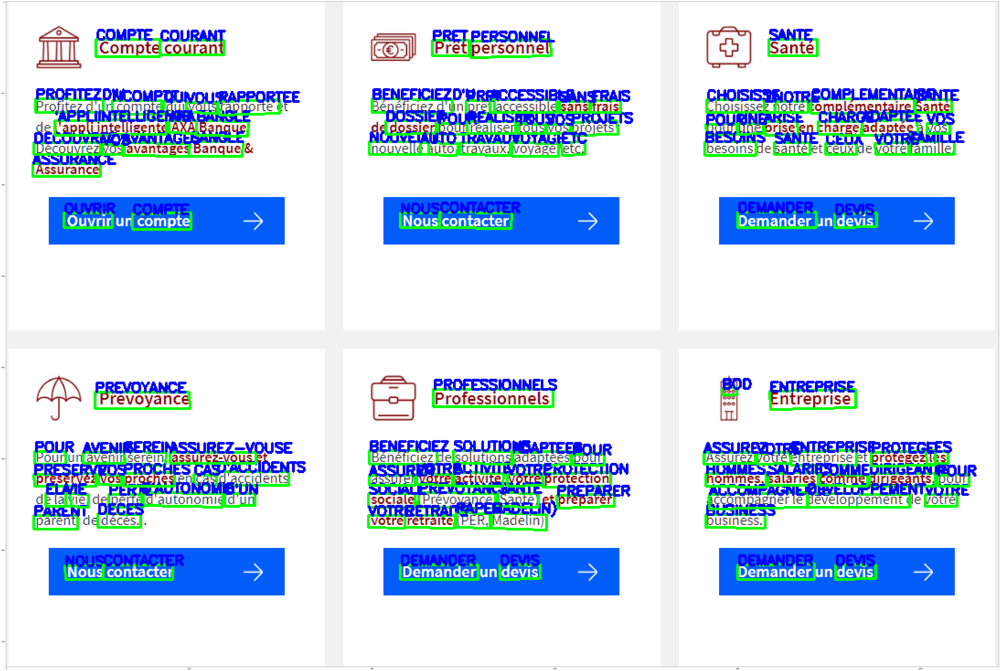

In [19]:
vis(im,word_instances)
plt.rcParams["figure.figsize"] = (100,100)

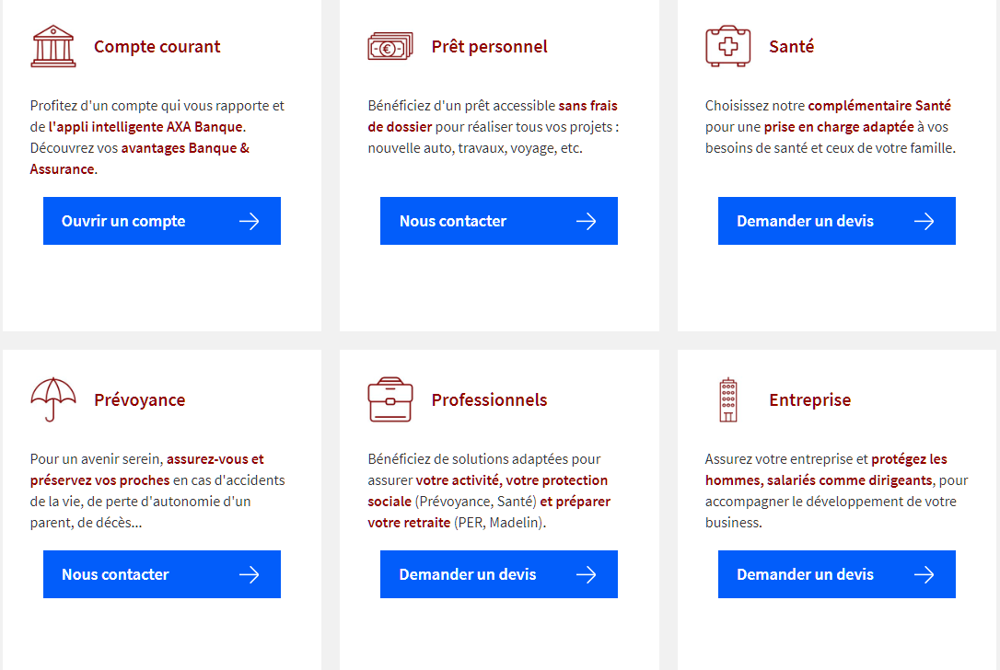

In [20]:
##ces boites montrent ce qui sort de charnet
import PIL
PIL.Image.fromarray(im)

In [21]:
char_bboxes[0]

array([ 94.       , 180.       , 103.       , 180.       , 103.       ,
       189.       ,  94.       , 189.       ,   0.9999999], dtype=float32)

In [22]:
char_scores[0]

array([8.5595593e-06, 6.7970198e-08, 1.9490775e-05, 4.7485943e-07,
       9.9994218e-01, 3.2575221e-07, 4.8364893e-07, 3.2980680e-08,
       5.3346224e-07, 1.0741010e-10, 1.5604028e-08, 4.3622885e-07,
       7.2916388e-09, 2.4707228e-07, 9.6693668e-07, 7.3371524e-08,
       1.3105858e-09, 1.2144642e-06, 8.1848948e-06, 1.1194535e-06,
       7.6973050e-09, 8.0934242e-08, 1.6153191e-08, 1.1907219e-07,
       5.4804140e-08, 4.1097534e-09, 5.7916774e-09, 4.8878190e-10,
       6.1328116e-08, 4.1318269e-09, 1.4795341e-09, 3.1931160e-10,
       1.8734511e-07, 9.2974059e-11, 4.5222089e-07, 6.3844113e-10,
       3.8353292e-07, 3.6992334e-09, 5.6711663e-10, 3.0258504e-10,
       2.7327610e-10, 3.6008238e-08, 1.2321859e-06, 5.1298210e-10,
       1.7260693e-10, 3.0477010e-10, 5.2717954e-09, 2.5468429e-08,
       2.1819358e-07, 2.2489907e-10, 4.9510554e-06, 4.2227807e-08,
       7.1771046e-06, 2.4898972e-08, 2.6710487e-10, 2.9903839e-07,
       3.7906567e-10, 2.8377937e-07, 1.7003199e-10, 1.4209223e

In [23]:
print(word_instances[0].word_bbox,
word_instances[0].word_bbox_score,
word_instances[0].text,
word_instances[0].text_score)
#,word_instances[0].char_scores)

[431. 231. 474. 231. 474. 247. 431. 247.] 0.99999976 NOUS 0.9998777


In [41]:
dico=load_char_dict(cfg.CHAR_DICT_FILE)
def vis2(img, char_bboxes, char_scores):
    img_word_ins = img.copy()
    index=0
    for box in char_bboxes:
        cv2.polylines(img_word_ins, [box[:8].reshape((-1, 2)).astype(np.int32)],
                      True, (0, 255, 0), 1)
        cv2.putText(
            img_word_ins,
            #il faut changer le 'a' mais ou est le décodage des lettres???
            '{}'.format(   dico[np.argmax(char_scores[index])]   ),
            (box[0], box[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1
        )
        index+=1
    plt.imshow(img_word_ins)

In [25]:
dico[0]

'A'

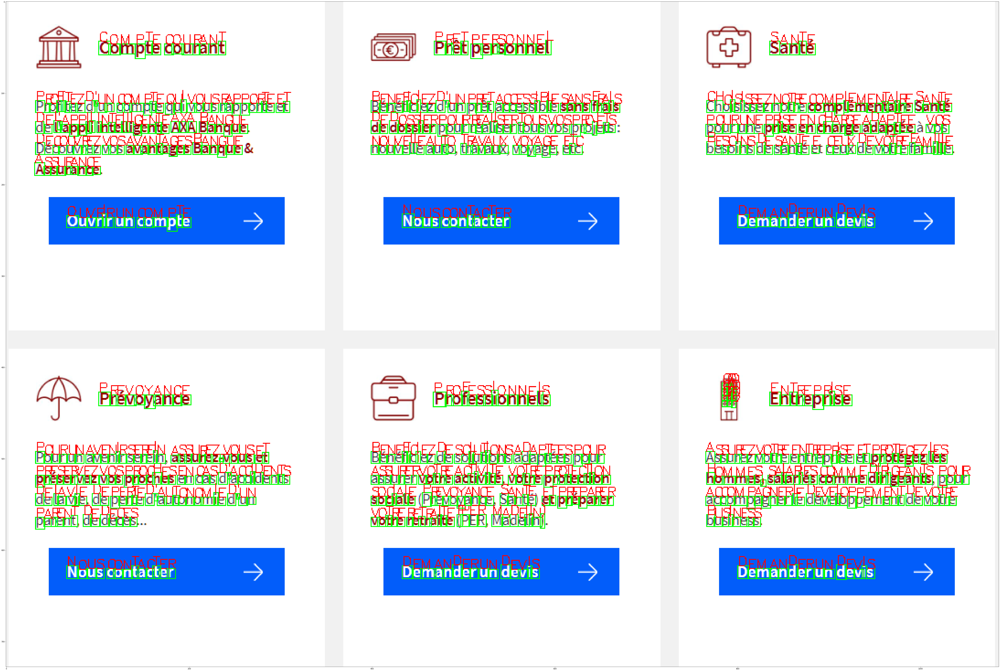

In [26]:
vis2(im, char_bboxes, char_scores)
plt.rcParams["figure.figsize"] = (100,100)

In [ ]:
#main(image_dir, results_dir)

Processing dondada.jpg...


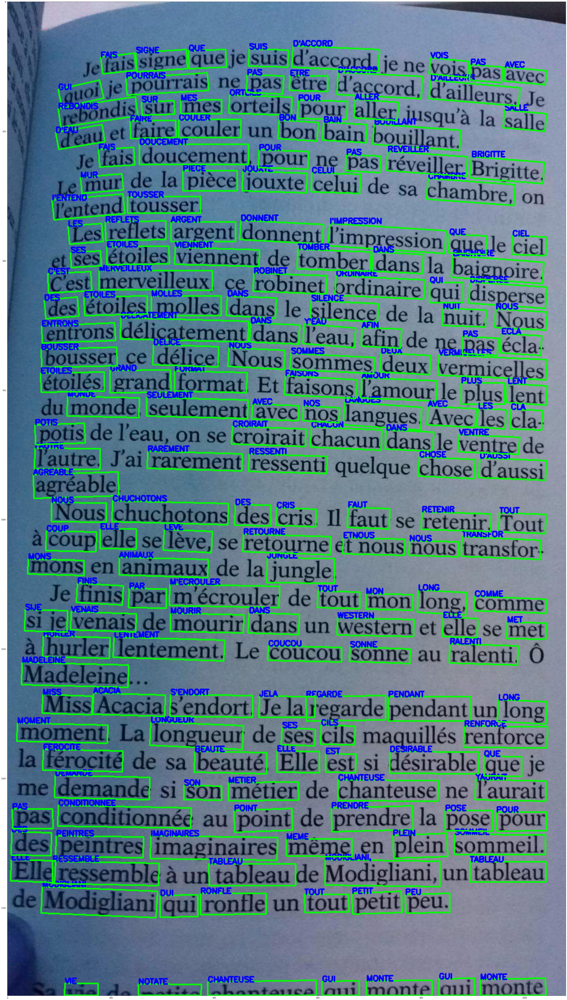

In [40]:
vis(im,word_instances)
plt.rcParams["figure.figsize"] = (100,100)

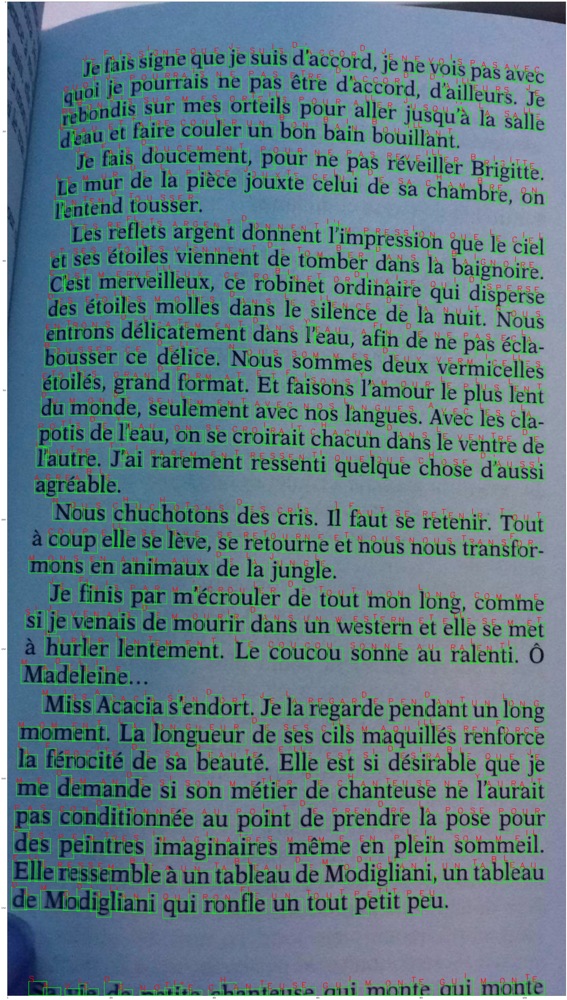

In [42]:
vis2(im, char_bboxes, char_scores)
plt.rcParams["figure.figsize"] = (100,100)